# Project 3 - Artificial Neural Networks

## Deliverables

As part of this project, you should deliver the following materials:

1. [**4-page IEEE-format paper**](https://www.ieee.org/conferences/publishing/templates.html). Write a paper with no more than 4 pages addressing the questions posed below. When writing this report, consider a business-oriented person as your reader (e.g. your PhD advisor, your internship manager, etc.). Tell *the story* for each datasets' goal and propose solutions by addressing (at least) the questions posed below.

2. **Python Code**. Create two separate Notebooks: (1) "training.ipynb" used for training and hyperparameter tuning, (2) "test.ipynb" for evaluating the final trained model in the test set. The "test.ipynb" should load all trained objects and simply evaluate the performance. So don't forget to **push the trained models** to your repository to allow us to run it.

All of your code should run without any errors and be well-documented.

3. **README.md file**. Edit the readme.md file in your repository and how to use your code. If there are user-defined parameters, your readme.md file must clearly indicate so and demonstrate how to use your code. **Consider the case where the user wants to utilize your code to run on a different test set. Indicate in your readme.md file how this can be achieved.**

This is an **individual assignment**.

These deliverables are **due Wednesday, December 6 @ 11:59pm**. Late submissions will not be accepted, so please plan accordingly.

---

# Dataset 1: Flower Species Dataset

The training dataset is saved as a ```numpy``` array and contains a total of 1678 images from 10 classes. Each RBG image is of size $300\times 300 \times 3$. The 10 classes and its label encodings are:

| Flower Species | Roses | Magnolias | Lilies | Sunflowers | Orchids | Marigold | Hibiscus | Firebush | Pentas | Bougainvillea |
| ---------     | ------| ----------| -------| -----------| --------| ---------| ---------| ---------| -------| --------------|
| Label          |  0    |    1      |    2   |    3       |    4    |    5     |   6      |   7      |   8    |       9       |

In [1]:
class_names = ['Roses', 'Magnolias', 'Lilies', 'Sunflowers', 'Orchids',
               'Marigold', 'Hibiscus', 'Firebush', 'Pentas', 'Bougainvillea']

The goal is to utilize the training images to train a flower species classifier (an artificial neural network architecture), and make predictions for the test set.

Let's visualize the dataset:

In [2]:
import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

# Loading Training Data
X_train = np.load('data_train.npy').T
t_train = np.load('labels_train.npy')

print(X_train.shape, t_train.shape)

(1658, 270000) (1658,)


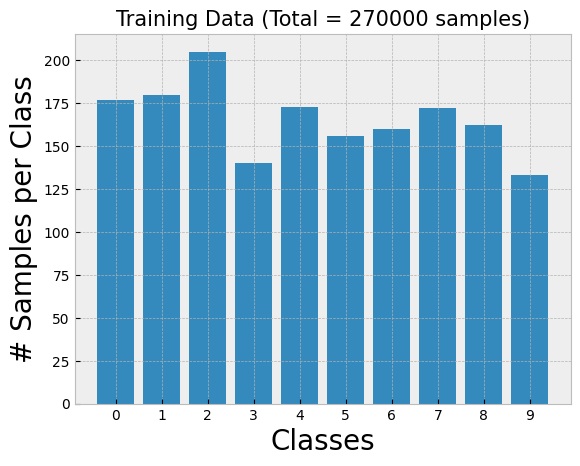

In [3]:
# Counting number samples per class
vals, counts = np.unique(t_train, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(X_train.shape[1])+' samples)',size=15);

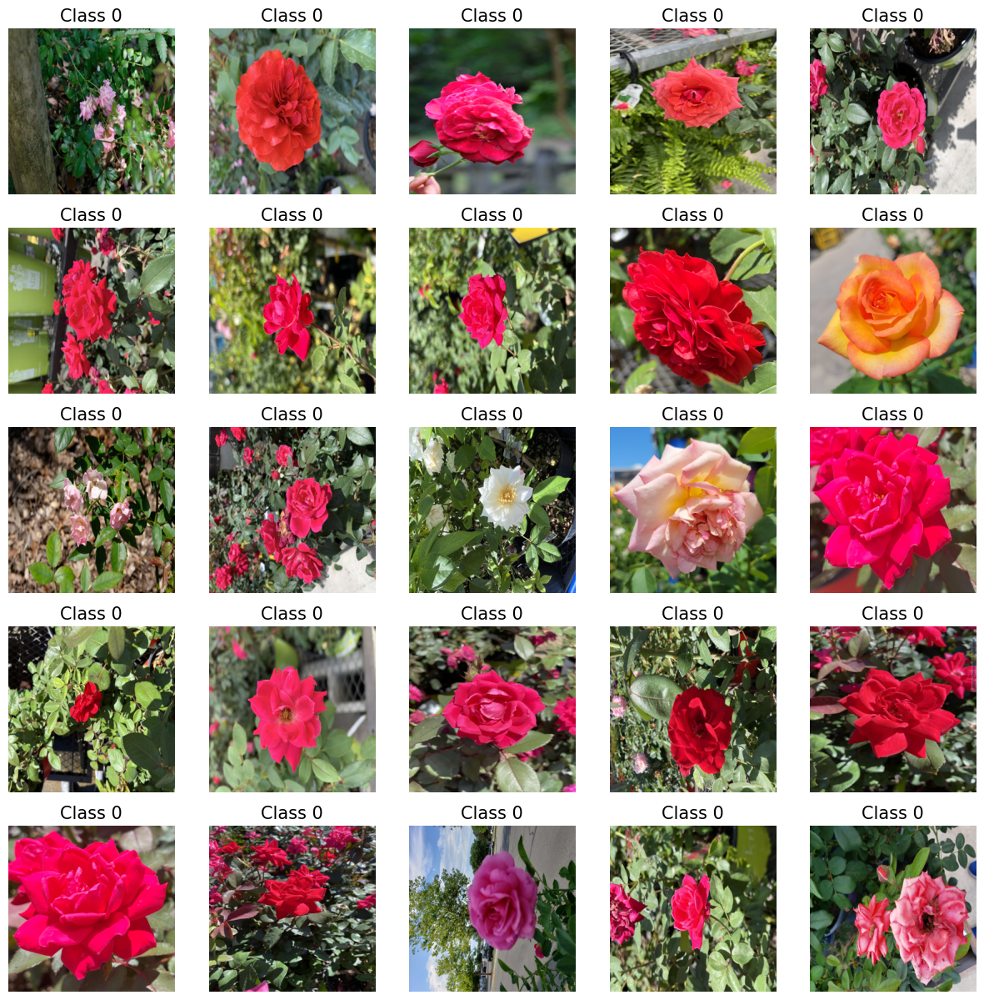

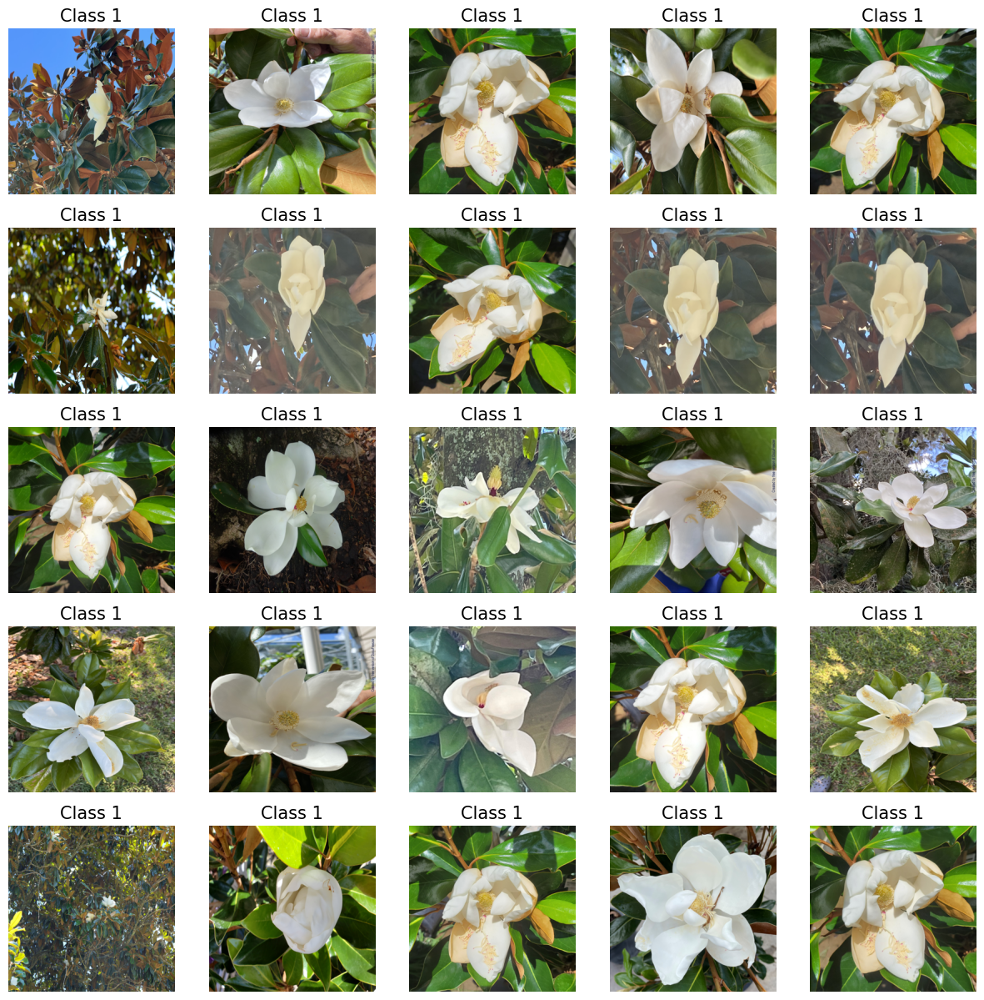

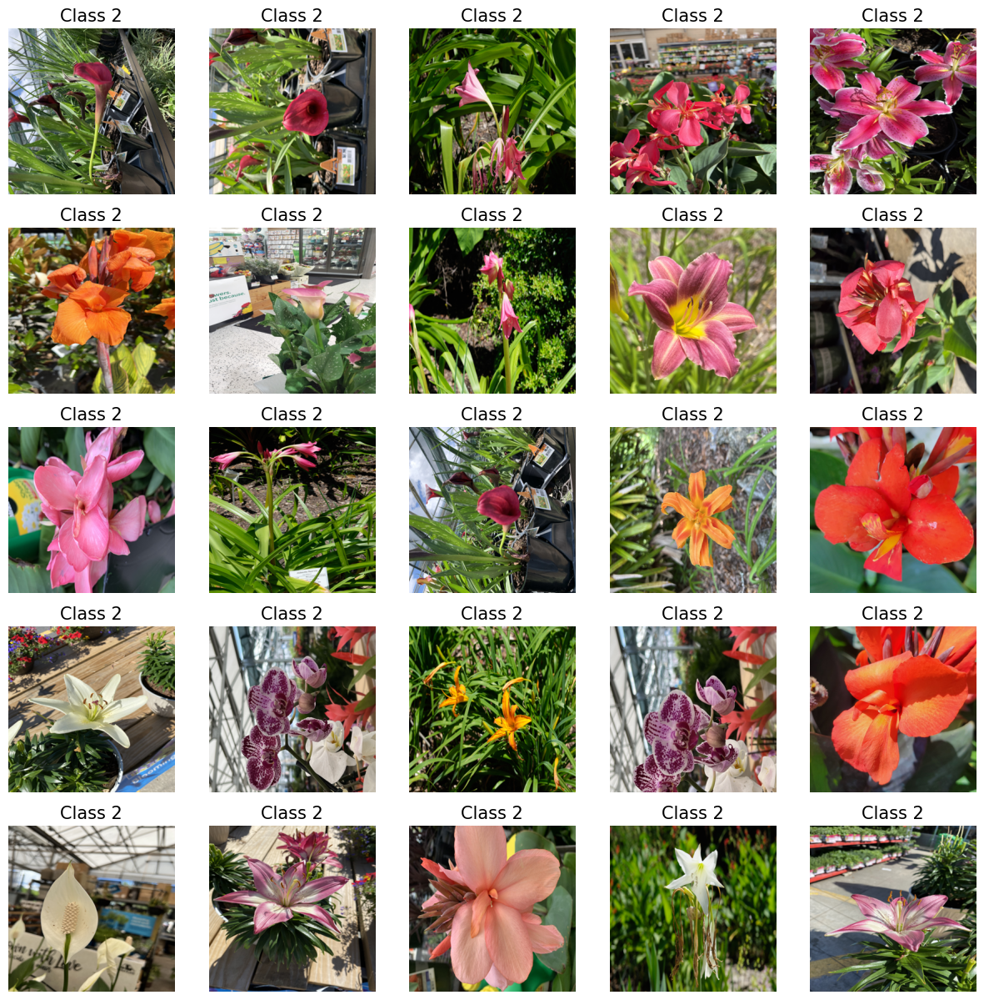

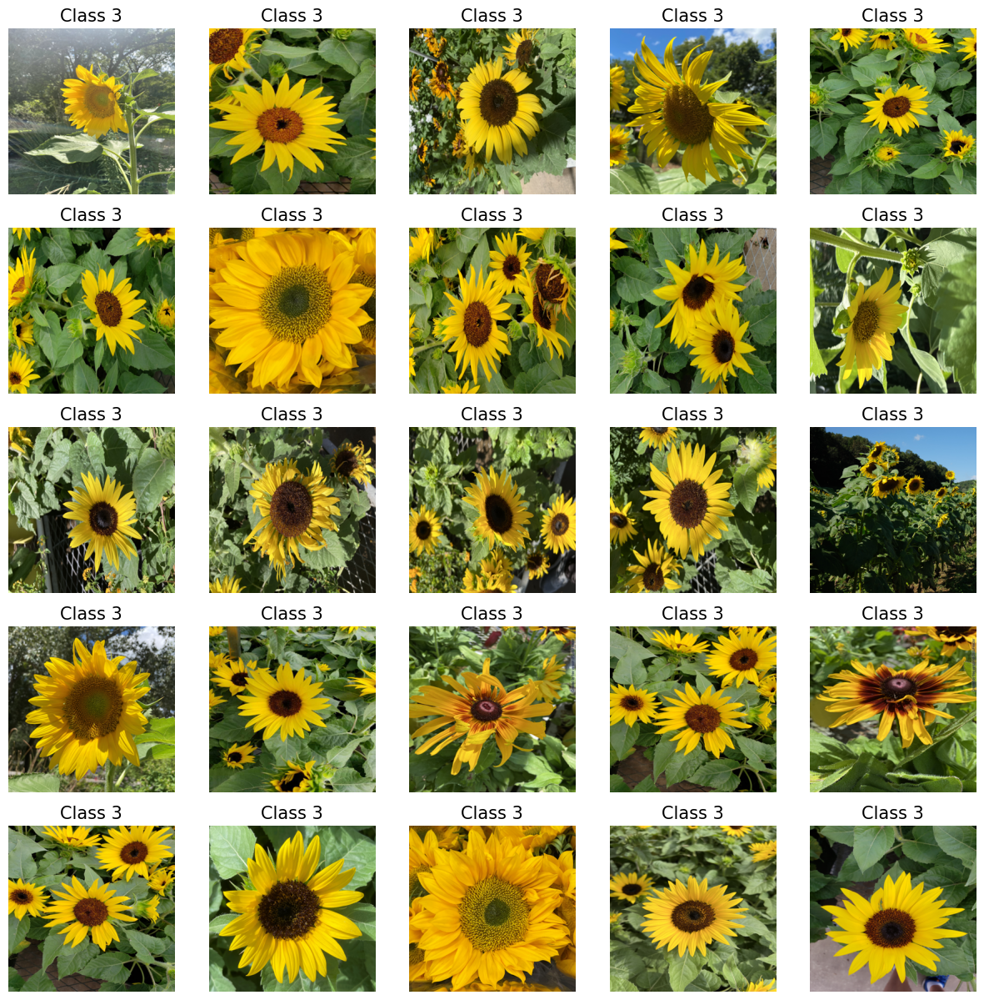

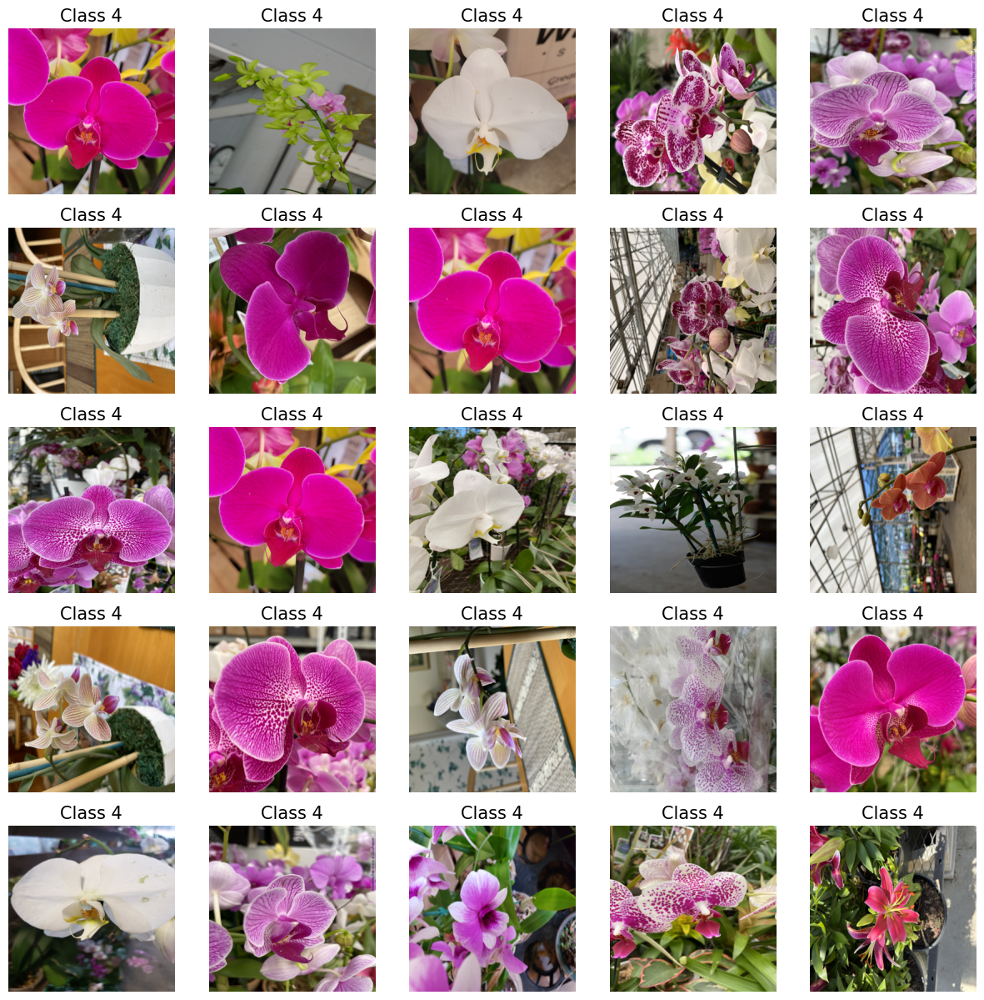

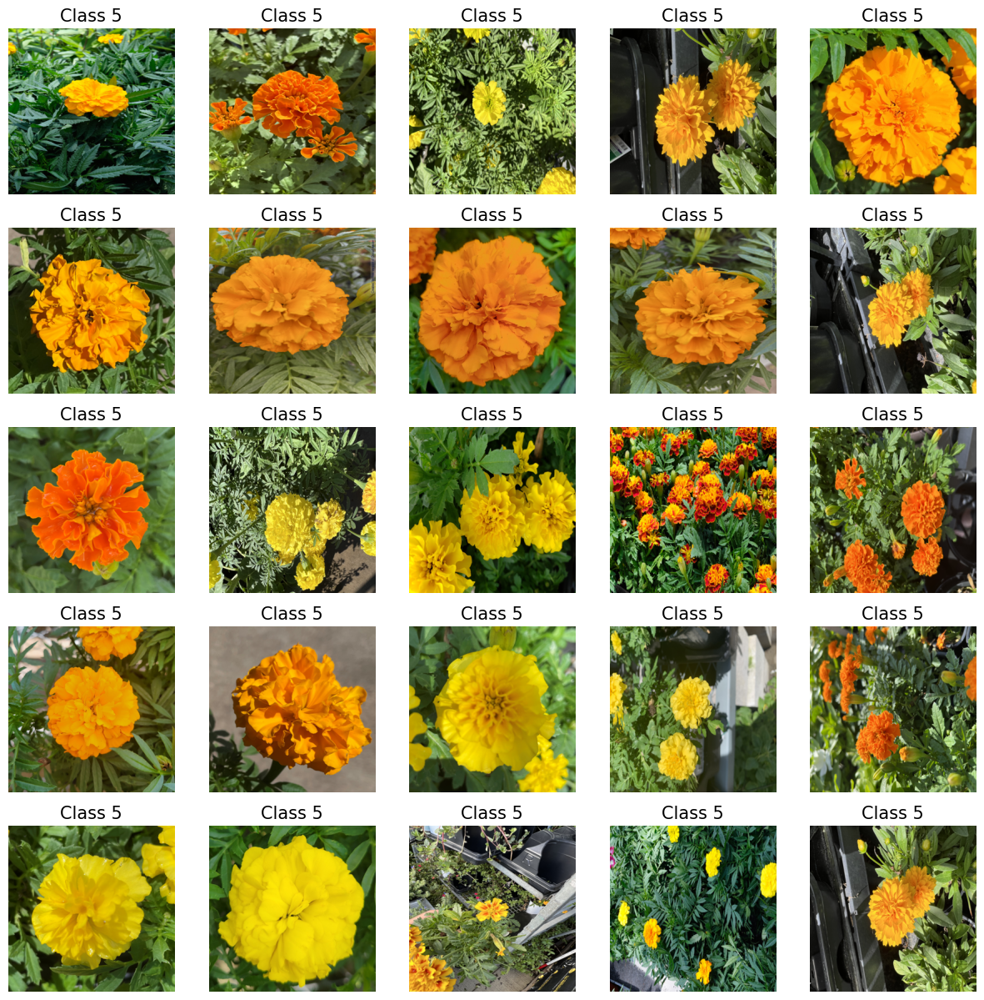

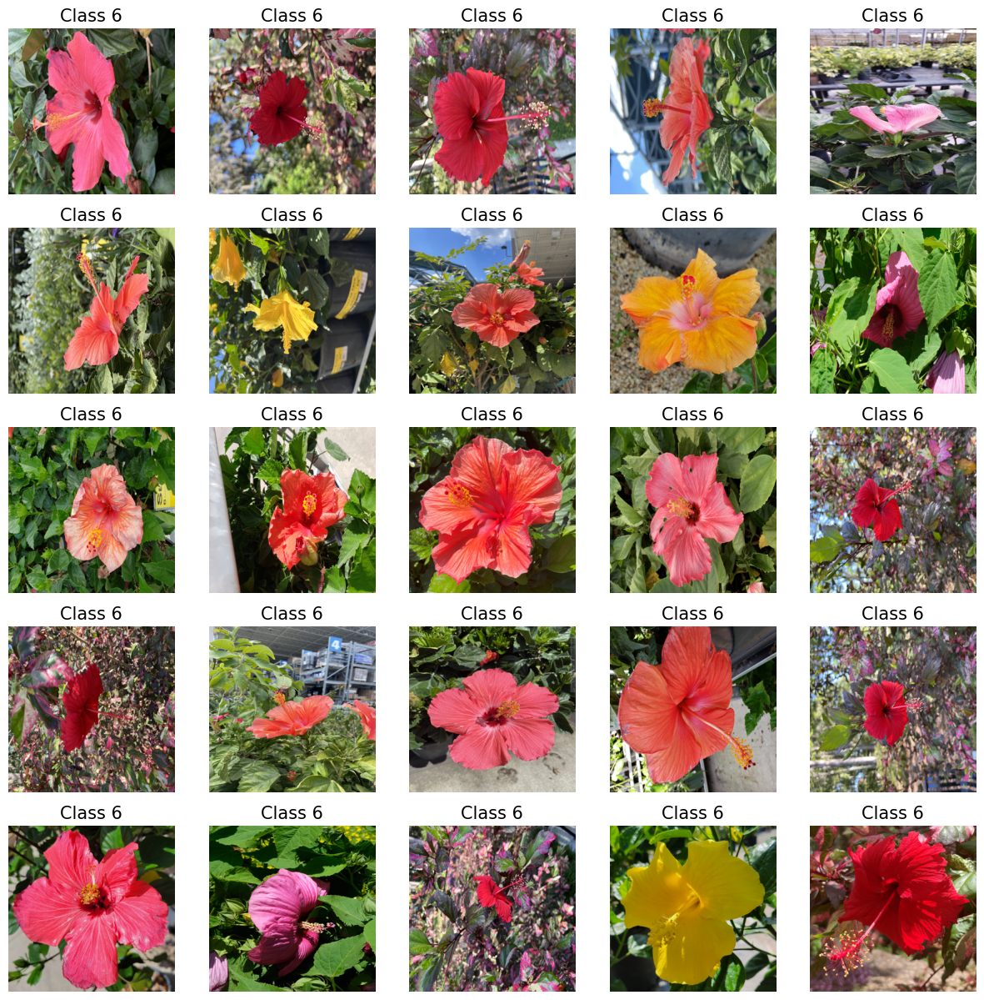

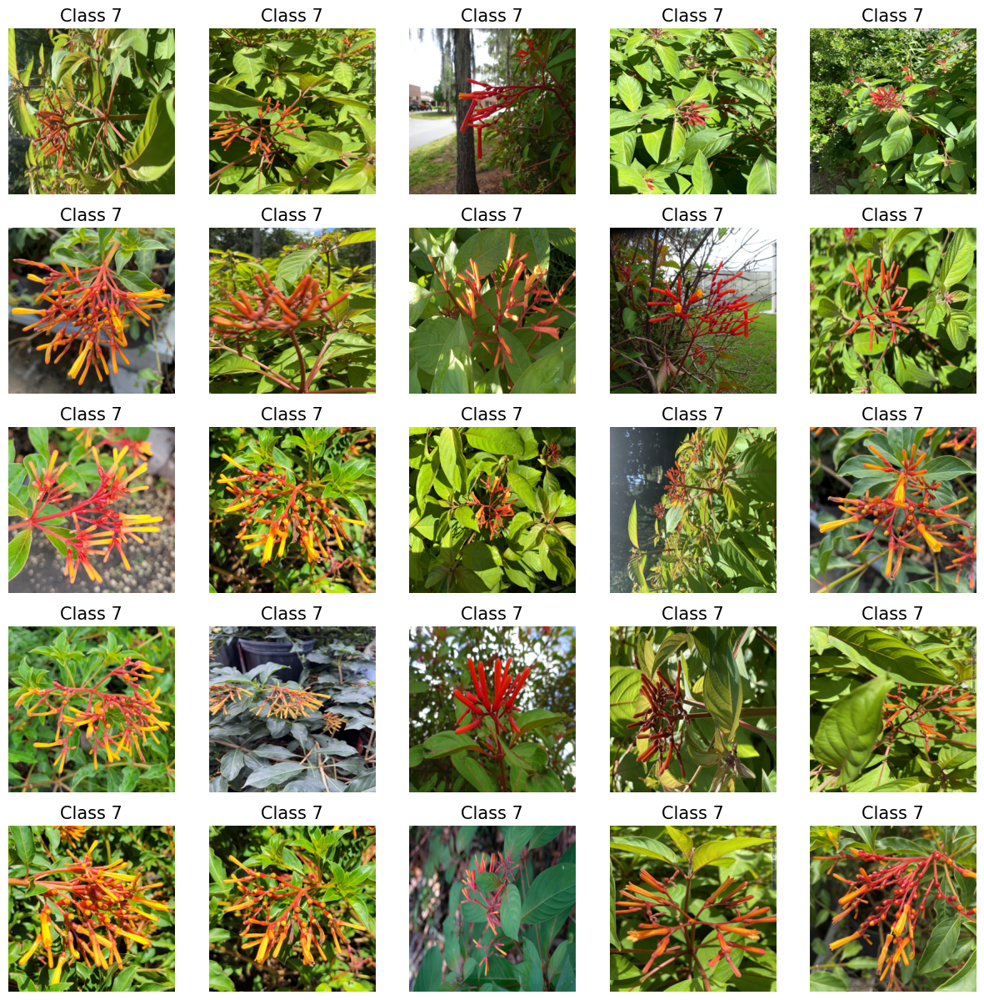

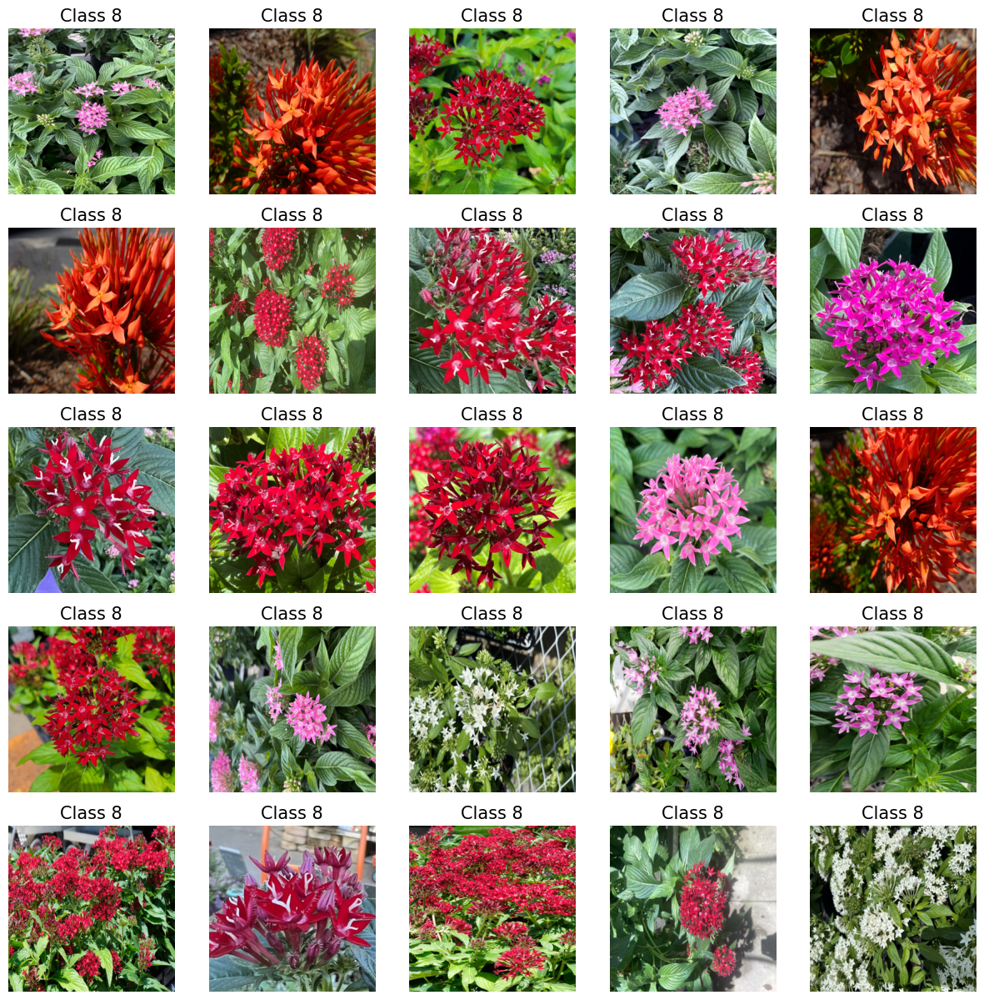

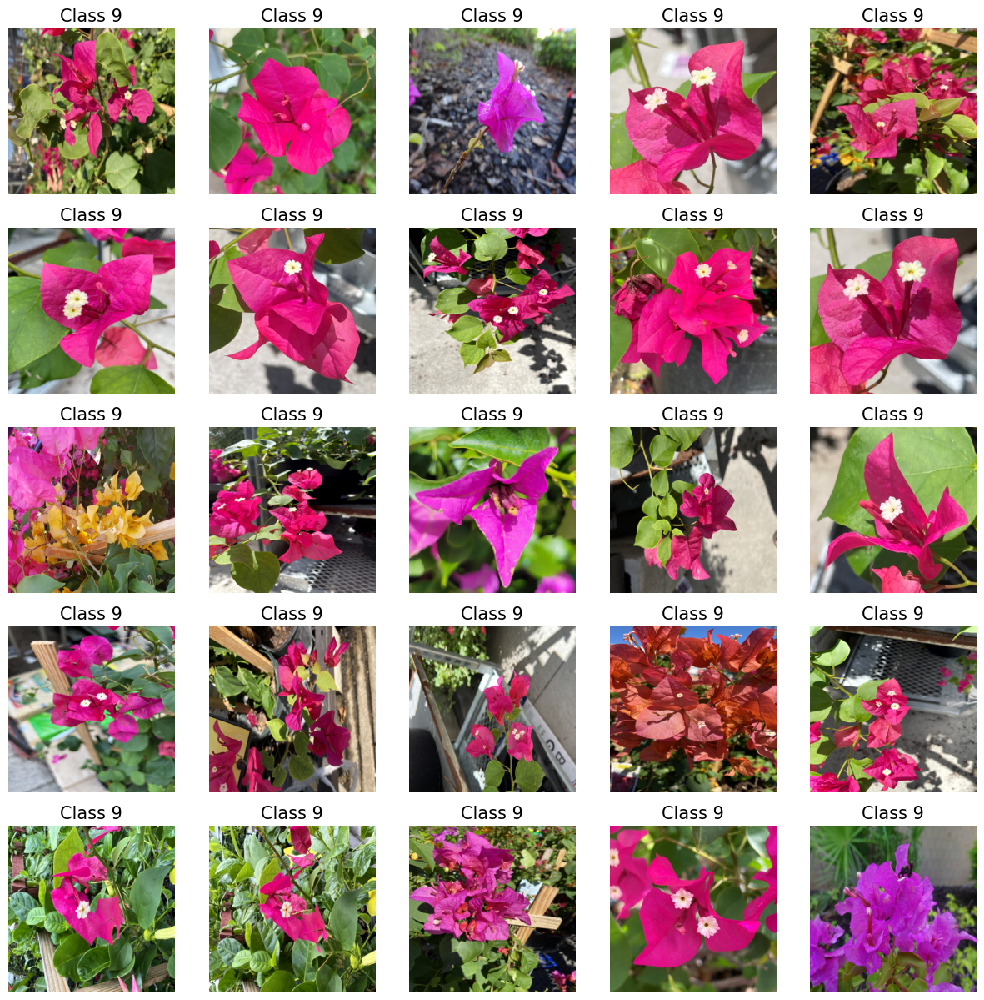

In [4]:
# Displaying some random examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train[rnd_sample[j],:].reshape((300,300,3)))
        plt.axis('off');plt.title('Class '+str(int(t_train[rnd_sample[j]])),size=15)
    plt.show()
    print('\n\n')

In [5]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder

X_train = X_train / 255.0

encoder = OneHotEncoder(sparse_output=False, categories='auto')
t_train_onehot = encoder.fit_transform(t_train.reshape(-1, 1))

X_train, X_val, t_train, t_val = train_test_split(X_train, t_train_onehot, test_size=0.2, random_state=42)


In [6]:
def create_model(input_shape, num_classes, learning_rate=0.001):
    model = tf.keras.Sequential([
        tf.keras.layers.Flatten(input_shape=input_shape),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(64, activation='relu'),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
    return model

input_shape = (300, 300, 3)
num_classes = t_train.shape[1]
model = create_model(input_shape, num_classes)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [7]:
X_train = X_train.reshape(-1, 300, 300, 3)
X_val = X_val.reshape(-1, 300, 300, 3)

In [8]:
X_train = X_train / 255.0
X_val = X_val / 255.0

In [9]:
print("X_train shape:", X_train.shape)
print("X_val shape:", X_val.shape)

X_train shape: (1326, 300, 300, 3)
X_val shape: (332, 300, 300, 3)


In [10]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
checkpoint = tf.keras.callbacks.ModelCheckpoint('best_model.keras', save_best_only=True)
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3)

history = model.fit(
    X_train, t_train,
    validation_data=(X_val, t_val),
    epochs=10,
    batch_size=32,
    callbacks=[early_stopping, checkpoint, lr_scheduler]
)


Epoch 1/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 53s 1s/step - accuracy: 0.1122 - loss: 2.3259 - val_accuracy: 0.1777 - val_loss: 2.1416 - learning_rate: 0.0010
Epoch 2/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 72s 988ms/step - accuracy: 0.2173 - loss: 2.1302 - val_accuracy: 0.3735 - val_loss: 1.8732 - learning_rate: 0.0010
Epoch 3/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 84s 1s/step - accuracy: 0.2829 - loss: 1.9426 - val_accuracy: 0.4096 - val_loss: 1.6935 - learning_rate: 0.0010
Epoch 4/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 39s 929ms/step - accuracy: 0.3010 - loss: 1.8508 - val_accuracy: 0.4006 - val_loss: 1.6304 - learning_rate: 0.0010
Epoch 5/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 40s 894ms/step - accuracy: 0.3491 - loss: 1.7443 - val_accuracy: 0.4548 - val_loss: 1.5778 - learning_rate: 0.0010
Epoch 6/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 44s 978ms/step - accuracy: 0.3610 - loss: 1.7331 - val_accuracy: 0.4970 - val_loss: 1.4791 - learning_rate: 0.0010
Epoch 7/10
42/42 ━━━━━━━━━━━━━━━━━━━━ 53s 1s/step - accuracy: 0.3976 - loss: 1.6112 - va

Training Accuracy: 0.5656, Validation Accuracy: 0.5151


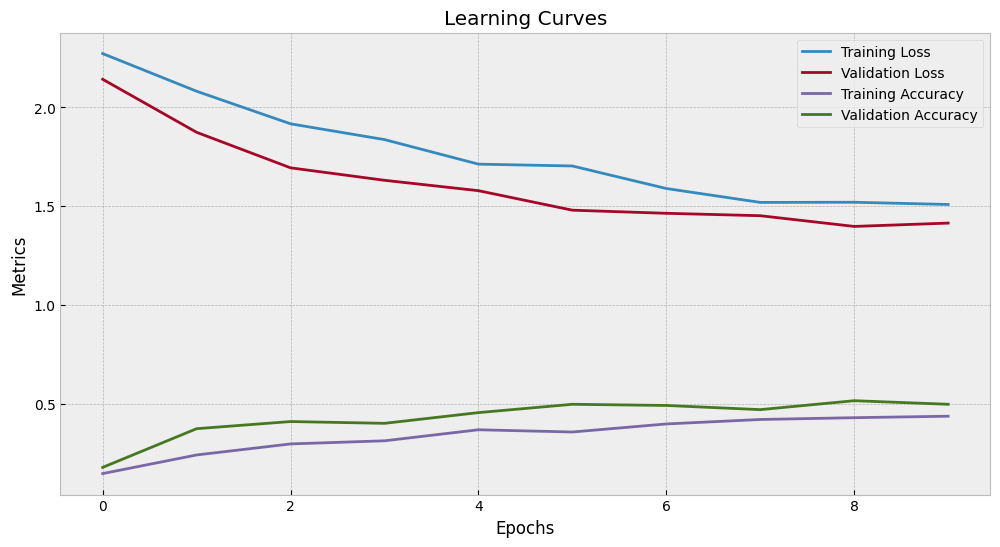

In [11]:
model = tf.keras.models.load_model('best_model.keras')

train_loss, train_acc = model.evaluate(X_train, t_train, verbose=0)
val_loss, val_acc = model.evaluate(X_val, t_val, verbose=0)

print(f"Training Accuracy: {train_acc:.4f}, Validation Accuracy: {val_acc:.4f}")

plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Metrics')
plt.legend()
plt.title('Learning Curves')
plt.show()


In [12]:
model.save('flower_species_model.keras')

---

# Dataset 2: Car Detection Dataset

This dataset contains labeled annotations for 559 training samples. Each annotation corresponds to a bounding box of the object **car**.

The goal is to train an object (car) detection artificial neural network using the training samples, and make predictions for the images in test.

Let's visualize the data:

In [13]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import cv2 # install opencv, if you don't already have it (https://pypi.org/project/opencv-python/)
import pandas as pd

In [14]:
bbox = pd.read_csv('train_bounding_boxes.csv')
bbox

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422
...,...,...,...,...,...
554,vid_4_9860.jpg,0.000000,198.321729,49.235251,236.223284
555,vid_4_9880.jpg,329.876184,156.482351,536.664239,250.497895
556,vid_4_9900.jpg,0.000000,168.295823,141.797524,239.176652
557,vid_4_9960.jpg,487.428988,172.233646,616.917699,228.839864


In [15]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [16]:
N = len(bbox)

for i in range(N):
    filename='/content/drive/MyDrive/training_images/'+bbox['image'][i]
    image = np.array(Image.open(filename))
    image_col = image.ravel()[:,np.newaxis]

    if i==0:
        X_train = image_col
    else:
        X_train = np.hstack((X_train, image_col))

X_train = X_train.T

t_train = bbox.drop('image', axis=1).round().to_numpy().astype(int)

X_train.shape, t_train.shape

((559, 770640), (559, 4))

Note that this code cell only collects data for images that contain a car within it. You may consider modifying to include all images. If no annotations is included, then assume there is no object and assign the target label [0,0,0,0].

In [17]:
(Nx,Ny,Nz) = image.shape

Nx, Ny, Nz

(380, 676, 3)

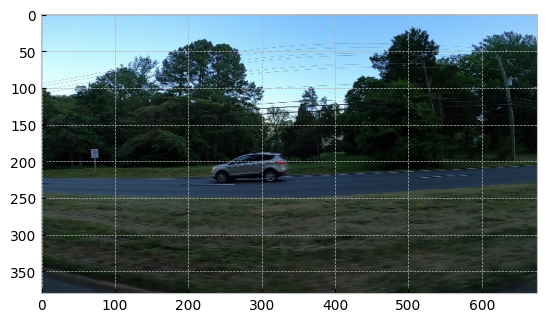

In [18]:
idx=N-1
x= image

plt.imshow(x)
cv2.rectangle(x, (t_train[idx,0], t_train[idx,1]),
              (t_train[idx,2], t_train[idx,3]),
              (255, 0, 0), 2);

In [19]:
X_train = X_train.reshape(-1, Nx, Ny, Nz)

X_train = X_train / 255.0


In [20]:
t_train = t_train.astype('float32')


In [21]:
from sklearn.model_selection import train_test_split

X_train, X_val, t_train, t_val = train_test_split(X_train, t_train, test_size=0.2, random_state=42)


In [22]:
import tensorflow as tf

def create_object_detection_model(input_shape):
    model = tf.keras.Sequential([
        tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        tf.keras.layers.MaxPooling2D((2, 2)),
        tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
        tf.keras.layers.MaxPooling2D((2, 2)),
        tf.keras.layers.Conv2D(128, (3, 3), activation='relu'),
        tf.keras.layers.MaxPooling2D((2, 2)),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(4, activation='linear')
    ])

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='mean_squared_error',
                  metrics=['mae'])
    return model

input_shape = (Nx, Ny, Nz)
model = create_object_detection_model(input_shape)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [23]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
checkpoint = tf.keras.callbacks.ModelCheckpoint('best_object_detection_model.keras', save_best_only=True)
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3)

history = model.fit(
    X_train, t_train,
    validation_data=(X_val, t_val),
    epochs=5,
    batch_size=32,
    callbacks=[early_stopping, checkpoint, lr_scheduler]
)


Epoch 1/5
14/14 ━━━━━━━━━━━━━━━━━━━━ 341s 24s/step - loss: 48363.9961 - mae: 174.8762 - val_loss: 21613.0176 - val_mae: 107.1515 - learning_rate: 0.0010
Epoch 2/5
14/14 ━━━━━━━━━━━━━━━━━━━━ 397s 25s/step - loss: 27433.6113 - mae: 123.2322 - val_loss: 21003.9336 - val_mae: 95.9557 - learning_rate: 0.0010
Epoch 3/5
14/14 ━━━━━━━━━━━━━━━━━━━━ 350s 23s/step - loss: 24919.0508 - mae: 115.2645 - val_loss: 21266.9160 - val_mae: 94.8741 - learning_rate: 0.0010
Epoch 4/5
14/14 ━━━━━━━━━━━━━━━━━━━━ 319s 23s/step - loss: 24765.0352 - mae: 114.3392 - val_loss: 21168.4395 - val_mae: 95.5591 - learning_rate: 0.0010
Epoch 5/5
14/14 ━━━━━━━━━━━━━━━━━━━━ 324s 23s/step - loss: 24241.2617 - mae: 114.4104 - val_loss: 21343.0215 - val_mae: 110.9894 - learning_rate: 0.0010


In [24]:
model = tf.keras.models.load_model('best_object_detection_model.keras')

train_loss, train_mae = model.evaluate(X_train, t_train, verbose=0)
val_loss, val_mae = model.evaluate(X_val, t_val, verbose=0)

print(f"Training Loss: {train_loss:.4f}, Training MAE: {train_mae:.4f}")
print(f"Validation Loss: {val_loss:.4f}, Validation MAE: {val_mae:.4f}")


Training Loss: 22648.8574, Training MAE: 103.1844
Validation Loss: 21003.9336, Validation MAE: 95.9557


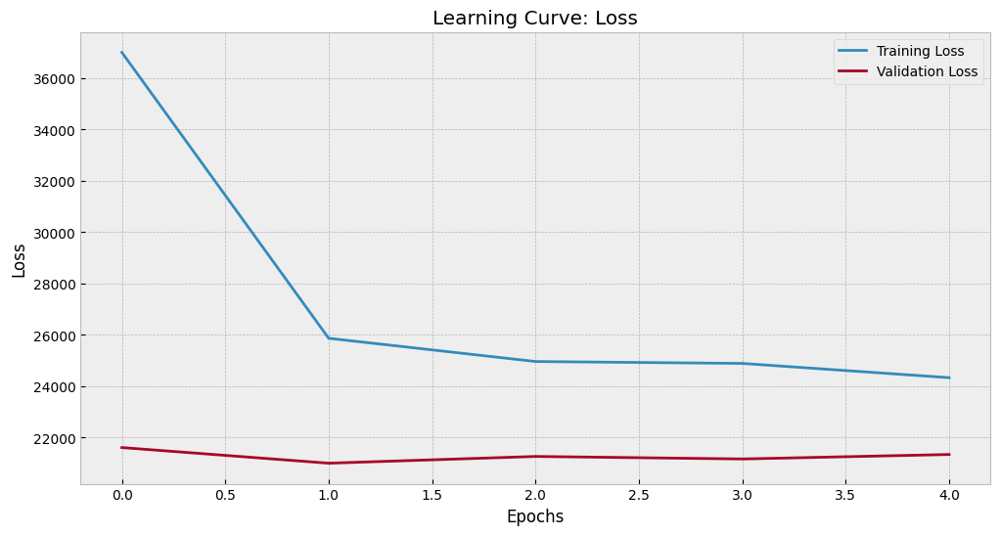

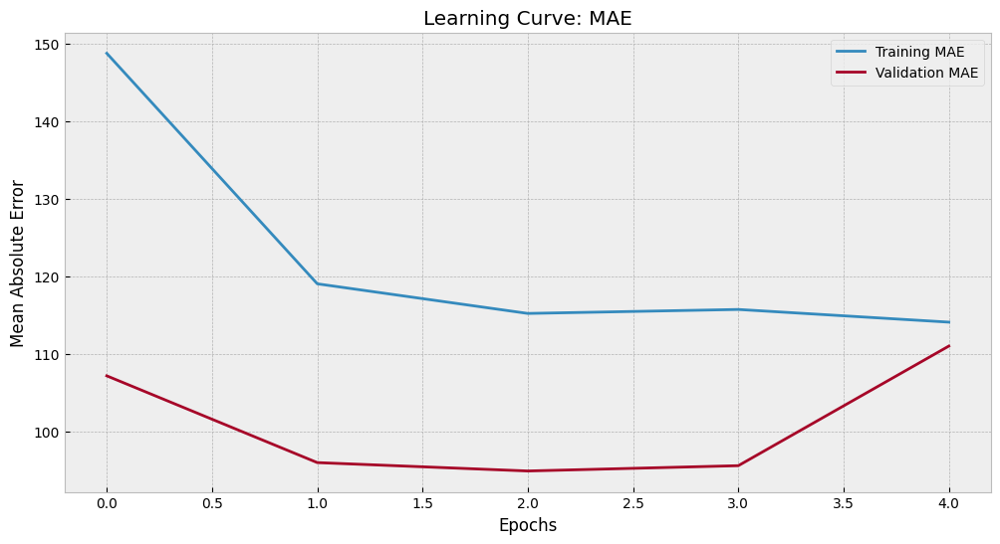

In [25]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Learning Curve: Loss')
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(history.history['mae'], label='Training MAE')
plt.plot(history.history['val_mae'], label='Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('Mean Absolute Error')
plt.legend()
plt.title('Learning Curve: MAE')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


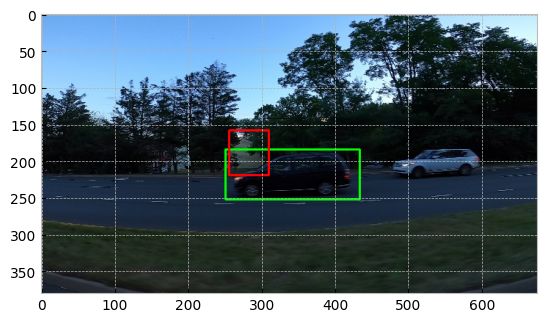

In [26]:
import cv2

idx = 0
image = X_val[idx]
true_bbox = t_val[idx]
pred_bbox = model.predict(image[np.newaxis, ...])[0]

image = (image * 255).astype('uint8')
true_bbox = true_bbox.astype(int)
pred_bbox = pred_bbox.astype(int)

cv2.rectangle(image, (true_bbox[0], true_bbox[1]), (true_bbox[2], true_bbox[3]), (0, 255, 0), 2)
cv2.rectangle(image, (pred_bbox[0], pred_bbox[1]), (pred_bbox[2], pred_bbox[3]), (255, 0, 0), 2)

plt.imshow(image)
plt.show()


In [27]:
model.save('car_detection_model.keras')

---

3. Discuss how you would validate performance in the test set given that no target labels are provided. Discuss also how you would address the case where no car is present in the image. For the latter, it may be useful consider all training images and add a fix target label (e.g. [0,0,0,0]) for all images without a car within it.

    * Consider the case where the exact bounding box location is not particularly the target. There an acceptable margin an error. Perhaps describe your approach in the context of overlapping Region of Interest (ROI).
    
    * You may use [MakeSenseAI](https://www.makesense.ai/) to create your own test labels (a small subset of test samples suffices) to demonstrate your validation metric.

Validation Without Target Labels

When target labels are unavailable for the test set, use the following strategies to evaluate the model:

1. Manual Annotation (Subset of Test Data)
Manually label a small subset of test images using tools like MakeSense.AI.
Annotate bounding boxes for cars and evaluate performance on this subset.
2. Indirect Metrics
Visualize predictions to assess model output qualitatively.
Analyze aggregate statistics (e.g., average bounding box size, confidence scores) to spot anomalies.
3. Proxy Evaluation
Use a hold-out validation set that resembles the test set for quantitative evaluation.
Measure metrics like mean squared error (MSE) or mean absolute error (MAE) for bounding box coordinates.
Handling Images Without Cars
1. Fixed Target for No-Car Images
Assign a target bounding box of [0, 0, 0, 0] for images with no cars.
Include no-car images in training data and adjust the loss function to handle them with reduced weight.
2. Model Modifications
Add a binary output (car_present) to indicate car presence.
Model outputs become [x_min, y_min, x_max, y_max, car_present].
3. Evaluation Metrics
Evaluate classification accuracy for detecting cars.
Measure bounding box regression error for images with cars.

Addressing Overlapping ROIs
1. Intersection over Union (IoU)
Measure IoU between predicted and ground truth bounding boxes.
Set a threshold (e.g., IoU > 0.5) to define a successful detection.
2. Metrics for Overlap
Use metrics like mean IoU or precision/recall for object detection.
3. Handling Multiple Cars
Use techniques like anchor boxes or non-maximum suppression (NMS) to detect multiple cars.
Match predicted boxes with ground truth using IoU.

Final Steps
Combine manual annotations and IoU thresholds for evaluation.
Include [0, 0, 0, 0] targets to evaluate false positives/negatives for no-car cases.
Visualize results with bounding boxes overlaid on test images and IoU distributions.
Set practical error margins (e.g., IoU > 0.5) based on the application.

---

# Submit Your Solution

Confirm that you've successfully completed the assignment.

Along with the Notebook, include a PDF of the notebook with your solutions.

```add``` and ```commit``` the final version of your work, and ```push``` your code to your GitHub repository.

Submit the URL of your GitHub Repository as your assignment submission on Canvas.

---